# <center>Análisis Complejidad Electoral 2019: Secciones Electorales <center>
## <center>Resumen de resultados y Mapas <center>

<br>

#### <center>INFOTEC-Maestría en Ciencia de Datos e Información <center>
#### <center>Autor: Miguel David Alvarez Hernández (mdalvarezh@gmail.com)<center>

In [ ]:
import datetime
now = datetime.datetime.now()
print ("Última versión:")
print (now.strftime("%Y-%m-%d %H:%M:%S"))

# Setup

In [2]:
import pandas as pd  
import numpy as np
import pandas_profiling
from itertools import combinations 
from dateutil.parser import parse 
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import plotly
import plotly.express as px

In [3]:
#se define diccionario de colores
colors = dict({'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                  'G3': 'grey',
                  'G4': 'red',
                  'G5': 'magenta'})

# Importación de resultados

In [4]:
#se carga el dataframe con los resultados de 6 indicadores (todos los PCA considerados en k-medias):
resultados_ind6 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/3_Agrupamiento-Kmeans/Resultados_Secc_Indic_PCA_Kmeans_Atip_ind6.csv", dtype={'EDO':int,'MUN':int})

#se carga el dataframe con los resultados de 6 indicadores, con log en LNE y Densidad_LNE (todos los PCA considerados en k-medias):
resultados_ind6_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/3_Agrupamiento-Kmeans/Resultados_Secc_Indic_PCA_Kmeans_Atip_ind6_tf.csv", dtype={'EDO':int,'MUN':int})
#se aplica np.exp rn LNE y Densidad_LNE para volver a las magnitudes originales
#resultados_ind6_tf['log(LNE)'] = np.exp(resultados_ind6_tf['log(LNE)'])
resultados_ind6_tf['log(Densidad_LNE)'] = np.exp(resultados_ind6_tf['log(Densidad_LNE)'])
#renombramos algunas columnas
resultados_ind6_tf=resultados_ind6_tf.rename(columns={"log(LNE)": "LNE", "log(Densidad_LNE)": "Densidad_LNE"})
resultados_ind6_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,404,R,6.679599,3114.052233,0.992982,...,0.015822,0.494467,-2.079005,0.766642,0.145209,-0.120979,0.762899,0.028320,G2,Tipica
1,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,470,M,7.178545,2633.165586,0.986038,...,0.018778,0.459351,-1.363579,0.803037,1.410818,-0.441983,0.222827,-0.043094,G2,Tipica
2,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,471,U,7.366445,3610.437533,0.989025,...,0.014270,0.512860,-1.806835,0.314006,0.965597,-0.567216,0.240176,0.022754,G2,Tipica
3,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,472,U,7.239933,3448.510713,0.990770,...,0.018002,0.617178,-1.724235,0.184408,0.487700,-0.456015,0.404533,-0.432180,G2,Tipica
4,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,473,M,9.037415,3840.761507,0.990124,...,0.013143,0.439638,-1.638394,-0.992583,1.593820,-2.020650,0.681931,0.785433,G2,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68385,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,352,U,5.978886,1827.533786,0.973718,...,0.032934,0.919404,2.248044,1.091231,1.299926,1.098096,-1.314330,-0.237932,G0,Tipica
68386,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,353,M,5.924256,865.200585,0.972815,...,0.041410,0.939714,3.432636,1.207635,1.153325,1.008162,-0.943577,0.127455,G0,Tipica
68387,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,354,R,4.615121,1.740839,0.973603,...,0.077790,0.942633,7.722265,3.438846,-0.681264,0.439350,0.968434,1.103935,G0,Atípica en ICE principal
68388,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,356,R,5.886104,166.822568,0.971920,...,0.055342,0.977154,5.007687,1.535965,0.887596,0.656250,-0.364164,0.272452,G0,Tipica


In [5]:
#se carga el dataframe con los resultados de 7 indicadores (todos los PCA considerados en k-medias):
resultados_ind7 = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/3_Agrupamiento-Kmeans/Resultados_Secc_Indic_PCA_Kmeans_Atip_ind7.csv", dtype={'EDO':int,'MUN':int})

#se carga el dataframe con los resultados de 7 indicadores, con log en LNE y Densidad_LNE (todos los PCA considerados en k-medias):
resultados_ind7_tf = pd.read_csv("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/3_Agrupamiento-Kmeans/Resultados_Secc_Indic_PCA_Kmeans_Atip_ind7_tf.csv", dtype={'EDO':int,'MUN':int})
#se aplica np.exp rn LNE y Densidad_LNE para volver a las magnitudes originales
resultados_ind7_tf['log(LNE)'] = np.exp(resultados_ind7_tf['log(LNE)'])
resultados_ind7_tf['log(Densidad_LNE)'] = np.exp(resultados_ind7_tf['log(Densidad_LNE)'])

#renombramos algunas columnas
resultados_ind7_tf=resultados_ind7_tf.rename(columns={"log(LNE)": "LNE", "log(Densidad_LNE)": "Densidad_LNE"})
resultados_ind7_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
0,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,404,R,796.0,3114.052233,0.992982,...,0.494467,-1.998150,0.896007,0.299150,0.934860,-0.324690,0.209161,-0.010563,G2,Tipica
1,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,470,M,1311.0,2633.165586,0.986038,...,0.459351,-1.261402,0.890648,1.483427,0.185499,-0.494662,-0.001004,-0.062374,G2,Tipica
2,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,471,U,1582.0,3610.437533,0.989025,...,0.512860,-1.877799,0.420301,1.049566,0.208261,-0.624435,0.063948,-0.028986,G2,Tipica
3,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,472,U,1394.0,3448.510713,0.990770,...,0.617178,-1.624315,0.296424,0.620355,0.630815,-0.597256,-0.340265,-0.038426,G2,Tipica
4,1,AGUASCALIENTES,10,SAN FRANCISCO DE LOS ROMO,1,473,M,8412.0,3840.761507,0.990124,...,0.439638,-1.832179,-0.895257,1.665424,-0.038708,-2.072460,0.933910,0.023131,G2,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68385,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,352,U,395.0,1827.533786,0.973718,...,0.919404,2.372541,0.954862,1.097777,-1.296321,1.401862,-0.563170,-0.108431,G3,Tipica
68386,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,353,M,374.0,865.200585,0.972815,...,0.939714,3.782032,1.012125,0.929745,-1.164888,1.270552,-0.090998,-0.102097,G3,Tipica
68387,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,354,R,101.0,1.740839,0.973603,...,0.942633,9.246257,3.039946,-0.908062,0.066689,0.385870,1.430218,-0.060159,G3,Atípica en ICE principal
68388,32,ZACATECAS,11,TRINIDAD GARCIA DE LA CADENA,2,356,R,360.0,166.822568,0.971920,...,0.977154,5.801376,1.269742,0.666433,-0.799544,0.819671,0.221832,-0.111531,G3,Tipica


<br>

# _Rankings_

## Escenario 1: (6 indicadores)

In [6]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind6.profile_report()

In [7]:
#se ordenan y obtienen las 10 secciones por nivel de complejidad (descendente en CP1) 
ranking_secc_top10_ind6 = resultados_ind6.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_secc_top10_ind6.to_csv(r'Resultados_Secc_ranking-top10_ind6.csv', index = None)
ranking_secc_top10_ind6

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
34808,15,MEXICO,68,OTZOLOTEPEC,18,6517,R,197.0,868.430638,0.926031,...,0.333093,0.990152,47.723236,-5.694701,6.912508,1.570346,15.697053,18.559173,G3,Atípica en ICE principal
9130,8,CHIHUAHUA,66,URUACHI,7,2696,R,26.0,0.071166,0.893192,...,0.200514,0.947617,29.797316,-9.176825,5.544357,6.999564,0.449514,7.948614,G3,Atípica en ICE principal
54447,25,SINALOA,17,SINALOA,3,3427,R,119.0,0.377753,0.969686,...,0.253252,0.879067,29.704012,-5.330546,3.729244,0.620525,18.809584,1.953060,G3,Atípica en ICE principal
9122,8,CHIHUAHUA,66,URUACHI,7,2687,R,299.0,1.595228,0.901337,...,0.231889,0.894185,28.151943,-10.589874,4.885661,7.851808,4.630007,0.714767,G3,Atípica en ICE principal
7767,8,CHIHUAHUA,9,BOCOYNA,7,147,R,697.0,4.130370,0.888898,...,0.208899,0.969446,27.012914,-10.480255,4.881299,8.744839,0.041397,2.440031,G3,Atípica en ICE principal
40260,19,NUEVO LEON,18,GARCIA,7,2547,R,1078.0,1494.734496,0.957388,...,0.235910,0.997565,26.912267,-3.389072,3.430503,0.847590,10.684609,7.735246,G3,Atípica en ICE principal
9129,8,CHIHUAHUA,66,URUACHI,7,2695,R,327.0,2.315192,0.908692,...,0.192915,0.906163,22.755839,-9.548780,4.138795,7.274305,2.226043,-0.288466,G3,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,232.0,1879.728291,0.919922,...,0.153791,0.993537,19.760430,-6.806977,3.853788,5.197898,-0.226914,3.545455,G3,Atípica en ICE principal
41159,19,NUEVO LEON,21,GRAL. ESCOBEDO,2,2737,U,26.0,3448.118547,0.981348,...,0.193536,0.974279,18.492556,-1.639343,2.644905,-1.285789,10.350564,4.855801,G3,Atípica en ICE principal
48935,23,QUINTANA ROO,9,TULUM,1,948,U,1089.0,271.698771,0.965854,...,0.181189,0.955291,17.750934,-3.801774,2.066419,1.436260,8.777240,0.667178,G3,Atípica en ICE principal


In [8]:
#se obtienen las secciones de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_secc_ind6 = resultados_ind6.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind6['CP1 (ICE principal)']
ranking_secc_edo_ind6 = resultados_ind6[idx_rank_secc_ind6]
ranking_secc_edo_ind6.to_csv(r'Resultados_Secc_ranking-edo_ind6.csv', index = None)
ranking_secc_edo_ind6

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
328,1,AGUASCALIENTES,1,AGUASCALIENTES,2,594,U,4134.0,3320.551262,0.980598,...,0.102242,0.976925,8.000549,-0.335219,-0.721439,1.221466,3.966954,0.147156,G3,Atípica en ICE principal
2180,2,BAJA CALIFORNIA,4,TIJUANA,8,1869,R,1701.0,13346.931772,0.976713,...,0.107855,0.968223,8.582919,-1.169877,1.236615,1.158550,4.042261,0.187604,G3,Atípica en ICE principal
3022,3,BAJA CALIFORNIA SUR,2,MULEGE,1,105,R,154.0,20.878525,0.953756,...,0.072334,0.955077,8.443075,-3.688953,1.842669,2.220025,-1.155946,0.971109,G3,Atípica en ICE principal
3181,4,CAMPECHE,10,CANDELARIA,2,295,R,1611.0,1822.524119,0.970668,...,0.098904,0.952099,7.627921,-2.163136,0.692287,1.394203,2.189934,-0.380195,G3,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,232.0,1879.728291,0.919922,...,0.153791,0.993537,19.760430,-6.806977,3.853788,5.197898,-0.226914,3.545455,G3,Atípica en ICE principal
5471,6,COLIMA,8,MANZANILLO,2,224,R,370.0,736.322269,0.974949,...,0.054839,0.898942,4.314768,-1.896676,0.849484,0.480152,0.460688,0.015060,G3,Atípica en ICE principal
7292,7,CHIAPAS,81,SILTEPEC,13,1192,R,1093.0,28.913814,0.949593,...,0.081939,0.933943,11.481320,-3.937951,1.755559,2.881854,0.075487,1.787141,G3,Atípica en ICE principal
9130,8,CHIHUAHUA,66,URUACHI,7,2696,R,26.0,0.071166,0.893192,...,0.200514,0.947617,29.797316,-9.176825,5.544357,6.999564,0.449514,7.948614,G3,Atípica en ICE principal
11713,9,CIUDAD DE MEXICO,7,IZTAPALAPA,19,2509,U,1598.0,12471.083261,0.981073,...,0.067661,0.992082,4.742127,-0.239873,0.768123,0.533561,1.613165,0.391604,G3,Atípica en ICE principal
17775,10,DURANGO,20,OTAEZ,1,956,R,156.0,1.190649,0.936438,...,0.084393,0.445270,8.508126,-7.158961,1.986627,5.377581,-1.643726,-0.361597,G3,Atípica en ICE principal


Animación de la proyección de las secciones en el espacio de las CP (tipología en color):

In [9]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind6, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_seccional',
                    color_discrete_map={
                'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                    'G3': 'grey'},
                    hover_name='SECC',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3  (6 indicadores)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_ind6.html")

Animación de la proyección de las secciones en el espacio de las CP (atipicidad en color):

In [10]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind6, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='SECC',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3 (6 indicadores)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_Atip_ind6.html")

## Escenario 2: (6 indicadores con transformación log en LNE y Densidad_LNE)

In [11]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind6_tf.profile_report()

In [12]:
#se ordenan y obtienen las 10 secciones por nivel de complejidad (descendente en CP1) 
ranking_secc_top10_ind6_tf = resultados_ind6_tf.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_secc_top10_ind6_tf.to_csv(r'Resultados_Secc_ranking-top10_ind6_tf.csv', index = None)
ranking_secc_top10_ind6_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
34808,15,MEXICO,68,OTZOLOTEPEC,18,6517,R,5.283204,868.430638,0.926031,...,0.333093,0.990152,48.005421,-1.184304,3.090671,5.169958,15.849746,18.990023,G0,Atípica en ICE principal
9130,8,CHIHUAHUA,66,URUACHI,7,2696,R,3.258097,0.071166,0.893192,...,0.200514,0.947617,31.217916,6.635445,7.753660,3.512990,0.201250,7.991213,G0,Atípica en ICE principal
54447,25,SINALOA,17,SINALOA,3,3427,R,4.779123,0.377753,0.969686,...,0.253252,0.879067,30.778967,3.684272,-0.014808,1.386619,18.318521,2.172107,G0,Atípica en ICE principal
9122,8,CHIHUAHUA,66,URUACHI,7,2687,R,5.700444,1.595228,0.901337,...,0.231889,0.894185,29.324343,5.526869,10.133613,2.185940,5.012645,0.838704,G0,Atípica en ICE principal
7767,8,CHIHUAHUA,9,BOCOYNA,7,147,R,6.546785,4.130370,0.888898,...,0.208899,0.969446,28.028935,4.545293,11.691428,1.904922,0.611934,2.513278,G0,Atípica en ICE principal
40260,19,NUEVO LEON,18,GARCIA,7,2547,R,6.982863,1494.734496,0.957388,...,0.235910,0.997565,26.996555,-1.195268,2.069017,2.052264,10.927640,7.989757,G0,Atípica en ICE principal
9129,8,CHIHUAHUA,66,URUACHI,7,2695,R,5.789960,2.315192,0.908692,...,0.192915,0.906163,23.844194,5.317383,9.373626,1.747118,2.570889,-0.214454,G0,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,5.446737,1879.728291,0.919922,...,0.153791,0.993537,20.120542,2.371880,7.445715,3.689655,0.346247,3.723210,G0,Atípica en ICE principal
41159,19,NUEVO LEON,21,GRAL. ESCOBEDO,2,2737,U,3.258097,3448.118547,0.981348,...,0.193536,0.974279,18.629403,1.249951,-2.079887,4.542533,10.129157,5.154838,G0,Atípica en ICE principal
48935,23,QUINTANA ROO,9,TULUM,1,948,U,6.993015,271.698771,0.965854,...,0.181189,0.955291,18.037201,0.696981,2.420712,0.822184,8.992141,0.832492,G0,Atípica en ICE principal


In [13]:
#se obtienen las secciones de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_secc_ind6_tf = resultados_ind6_tf.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind6_tf['CP1 (ICE principal)']
ranking_secc_edo_ind6_tf = resultados_ind6_tf[idx_rank_secc_ind6_tf]
ranking_secc_edo_ind6_tf.to_csv(r'Resultados_Secc_ranking-edo_ind6_tf.csv', index = None)
ranking_secc_edo_ind6_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
328,1,AGUASCALIENTES,1,AGUASCALIENTES,2,594,U,8.327001,3320.551262,0.980598,...,0.102242,0.976925,7.682527,-1.372336,1.328669,-0.468221,4.234117,0.224698,G0,Atípica en ICE principal
2180,2,BAJA CALIFORNIA,4,TIJUANA,8,1869,R,7.438972,13346.931772,0.976713,...,0.107855,0.968223,8.497828,-0.888504,1.691383,0.847983,4.293240,0.297363,G0,Atípica en ICE principal
3022,3,BAJA CALIFORNIA SUR,2,MULEGE,1,105,R,5.036953,20.878525,0.953756,...,0.072334,0.955077,9.066557,3.266729,2.599554,1.306406,-1.271242,0.965288,G0,Atípica en ICE principal
3181,4,CAMPECHE,10,CANDELARIA,2,295,R,7.384610,1822.524119,0.970668,...,0.098904,0.952099,7.640608,0.057126,2.358087,0.319525,2.490573,-0.305928,G0,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,5.446737,1879.728291,0.919922,...,0.153791,0.993537,20.120542,2.371880,7.445715,3.689655,0.346247,3.723210,G0,Atípica en ICE principal
5471,6,COLIMA,8,MANZANILLO,2,224,R,5.913503,736.322269,0.974949,...,0.054839,0.898942,4.508957,1.292970,0.983896,0.986223,0.519751,0.062239,G0,Tipica
7292,7,CHIAPAS,81,SILTEPEC,13,1192,R,6.996681,28.913814,0.949593,...,0.081939,0.933943,11.967392,1.721091,3.997390,-0.017824,0.189230,1.775991,G0,Atípica en ICE principal
9130,8,CHIHUAHUA,66,URUACHI,7,2696,R,3.258097,0.071166,0.893192,...,0.200514,0.947617,31.217916,6.635445,7.753660,3.512990,0.201250,7.991213,G0,Atípica en ICE principal
16162,9,CIUDAD DE MEXICO,15,CUAUHTEMOC,8,4830,U,6.820016,22233.570945,0.974440,...,0.061959,0.985186,4.678970,-0.512493,1.664918,1.329630,0.672159,0.391611,G0,Tipica
17775,10,DURANGO,20,OTAEZ,1,956,R,5.049856,1.190649,0.936438,...,0.084393,0.445270,9.600761,6.286637,6.290805,0.566727,-1.679668,-0.414036,G0,Atípica en ICE principal


Animación de la proyección de las secciones en el espacio de las CP (tipología en color):

In [14]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind6_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_seccional',
                    color_discrete_map={
                'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                    'G3': 'grey'},
                    hover_name='SECC',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3  (6 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_ind6_tf.html")

Animación de la proyección de las secciones en el espacio de las CP (atipicidad en color):

In [15]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind6_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='SECC',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3 (6 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_Atip_ind6_tf.html")

## Escenario 3: (7 indicadores)

In [16]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind7.profile_report()

In [17]:
#se ordenan y obtienen las 10 secciones por nivel de complejidad (descendente en CP1) 
ranking_secc_top10_ind7 = resultados_ind7.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_secc_top10_ind7.to_csv(r'Resultados_Secc_ranking-top10_ind7.csv', index = None)
ranking_secc_top10_ind7

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
34808,15,MEXICO,68,OTZOLOTEPEC,18,6517,R,197.0,868.430638,0.926031,...,0.990152,55.567455,-1.887214,6.286630,0.409676,3.819609,23.456072,1.847757,G1,Atípica en ICE principal
54447,25,SINALOA,17,SINALOA,3,3427,R,119.0,0.377753,0.969686,...,0.879067,37.257871,-3.802707,3.632434,0.634051,12.879967,8.539472,6.347660,G1,Atípica en ICE principal
9122,8,CHIHUAHUA,66,URUACHI,7,2687,R,299.0,1.595228,0.901337,...,0.894185,34.601450,-8.588414,4.560738,6.951211,-0.040648,2.818735,1.938406,G1,Atípica en ICE principal
9130,8,CHIHUAHUA,66,URUACHI,7,2696,R,26.0,0.071166,0.893192,...,0.947617,33.948645,-6.344729,4.959142,5.543025,-6.365402,8.485428,0.040252,G1,Atípica en ICE principal
40260,19,NUEVO LEON,18,GARCIA,7,2547,R,1078.0,1494.734496,0.957388,...,0.997565,33.332829,-1.734886,3.237931,0.552941,5.602715,10.894213,0.419523,G1,Atípica en ICE principal
7767,8,CHIHUAHUA,9,BOCOYNA,7,147,R,697.0,4.130370,0.888898,...,0.969446,32.245312,-8.229038,4.453207,7.544423,-4.661215,2.978153,0.257029,G1,Atípica en ICE principal
9129,8,CHIHUAHUA,66,URUACHI,7,2695,R,327.0,2.315192,0.908692,...,0.906163,28.035203,-7.896808,3.854528,6.451913,-1.263873,0.981700,1.252938,G1,Atípica en ICE principal
41159,19,NUEVO LEON,21,GRAL. ESCOBEDO,2,2737,U,26.0,3448.118547,0.981348,...,0.974279,24.175928,-0.858598,2.616311,-1.173390,7.524216,7.775294,0.146710,G1,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,232.0,1879.728291,0.919922,...,0.993537,23.209168,-5.068190,3.501709,4.279967,-3.959432,3.726680,-0.346852,G1,Atípica en ICE principal
48935,23,QUINTANA ROO,9,TULUM,1,948,U,1089.0,271.698771,0.965854,...,0.955291,23.167424,-3.014802,2.037104,1.440444,6.391855,3.557836,1.653924,G1,Atípica en ICE principal


In [18]:
#se obtienen las secciones de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_secc_ind7 = resultados_ind7.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind7['CP1 (ICE principal)']
ranking_secc_edo_ind7 = resultados_ind7[idx_rank_secc_ind7]
ranking_secc_edo_ind7.to_csv(r'Resultados_Secc_ranking-edo_ind7.csv', index = None)
ranking_secc_edo_ind7

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
328,1,AGUASCALIENTES,1,AGUASCALIENTES,2,594,U,4134.0,3320.551262,0.980598,...,0.976925,10.733096,-0.079845,-0.660902,1.368192,3.413335,1.319589,0.118584,G1,Atípica en ICE principal
2180,2,BAJA CALIFORNIA,4,TIJUANA,8,1869,R,1701.0,13346.931772,0.976713,...,0.968223,11.561797,-0.893952,1.270477,1.219073,3.300425,1.409647,0.173876,G1,Atípica en ICE principal
3022,3,BAJA CALIFORNIA SUR,2,MULEGE,1,105,R,154.0,20.878525,0.953756,...,0.955077,9.615513,-2.835740,1.638847,1.717183,-2.782088,0.824170,0.040800,G1,Atípica en ICE principal
3181,4,CAMPECHE,10,CANDELARIA,2,295,R,1611.0,1822.524119,0.970668,...,0.952099,10.305387,-1.856354,0.684154,1.365294,1.766168,0.287436,-0.204590,G1,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,232.0,1879.728291,0.919922,...,0.993537,23.209168,-5.068190,3.501709,4.279967,-3.959432,3.726680,-0.346852,G1,Atípica en ICE principal
5594,6,COLIMA,1,COLIMA,1,78,M,220.0,425.952835,0.987345,...,0.968288,5.639639,-0.328584,0.664712,-1.147453,1.708535,1.439557,-0.125093,G1,Atípica en ICE principal
7292,7,CHIAPAS,81,SILTEPEC,13,1192,R,1093.0,28.913814,0.949593,...,0.933943,12.692427,-2.759632,1.505162,2.276943,-2.662817,2.188393,1.019630,G1,Atípica en ICE principal
9122,8,CHIHUAHUA,66,URUACHI,7,2687,R,299.0,1.595228,0.901337,...,0.894185,34.601450,-8.588414,4.560738,6.951211,-0.040648,2.818735,1.938406,G1,Atípica en ICE principal
11713,9,CIUDAD DE MEXICO,7,IZTAPALAPA,19,2509,U,1598.0,12471.083261,0.981073,...,0.992082,6.215223,-0.043941,0.774443,0.535285,1.243451,0.837631,-0.204388,G1,Atípica en ICE principal
17471,10,DURANGO,24,PUEBLO NUEVO,1,1062,R,117.0,0.656036,0.942717,...,0.762998,12.990360,-8.738502,1.828093,6.160552,4.384151,-9.055553,0.919400,G1,Atípica en ICE principal


Animación de la proyección de las secciones en el espacio de las CP (tipología en color):

In [19]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_seccional',
                    color_discrete_map={
                'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                    'G3': 'grey'},
                    hover_name='SECC',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3 (7 indicadores)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_ind7.html")

Animación de la proyección de las secciones en el espacio de las CP (atipicidad en color):

In [20]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='SECC',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3 (7 indicadores)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_Atip_ind7.html")


## Escenario 4: (7 indicadores con transformación log previamente en LNE y Densidad_LNE)

In [21]:
#con pandas_profiling se crea una interface para visualizar un resumen del dataframe de los resultados
#resultados_ind7_tf.profile_report()

In [22]:
#se ordenan y obtienen las 10 secciones por nivel de complejidad (descendente en CP1) 
ranking_secc_top10_ind7_tf = resultados_ind7_tf.sort_values(by='CP1 (ICE principal)', ascending=False).head(10)
#se guarda el ranking
ranking_secc_top10_ind7_tf.to_csv(r'Resultados_Secc_ranking-top10_ind7_tf.csv', index = None)
ranking_secc_top10_ind7_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
34808,15,MEXICO,68,OTZOLOTEPEC,18,6517,R,197.0,868.430638,0.926031,...,0.990152,55.452113,-3.627232,1.941603,4.900545,3.669617,23.856540,1.928214,G3,Atípica en ICE principal
54447,25,SINALOA,17,SINALOA,3,3427,R,119.0,0.377753,0.969686,...,0.879067,37.927056,2.269060,0.131599,12.413191,-1.717900,8.615326,6.395524,G3,Atípica en ICE principal
9122,8,CHIHUAHUA,66,URUACHI,7,2687,R,299.0,1.595228,0.901337,...,0.894185,35.238302,4.094115,9.393203,0.931942,1.754813,2.978928,1.976715,G3,Atípica en ICE principal
9130,8,CHIHUAHUA,66,URUACHI,7,2696,R,26.0,0.071166,0.893192,...,0.947617,34.871336,4.921778,6.189795,-5.601655,4.553973,8.347344,0.034347,G3,Atípica en ICE principal
40260,19,NUEVO LEON,18,GARCIA,7,2547,R,1078.0,1494.734496,0.957388,...,0.997565,33.185845,-2.441353,1.902585,6.139254,0.473256,11.218178,0.482186,G3,Atípica en ICE principal
7767,8,CHIHUAHUA,9,BOCOYNA,7,147,R,697.0,4.130370,0.888898,...,0.969446,32.749090,3.113124,10.589233,-3.479684,2.480031,3.117532,0.294911,G3,Atípica en ICE principal
9129,8,CHIHUAHUA,66,URUACHI,7,2695,R,327.0,2.315192,0.908692,...,0.906163,28.650940,4.146042,8.685242,-0.392885,1.665363,1.087937,1.280105,G3,Atípica en ICE principal
41159,19,NUEVO LEON,21,GRAL. ESCOBEDO,2,2737,U,26.0,3448.118547,0.981348,...,0.974279,24.211887,0.457161,-1.826670,8.209425,2.668012,8.059415,0.150874,G3,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,232.0,1879.728291,0.919922,...,0.993537,23.281878,1.331197,6.619113,-2.427303,4.143782,4.001334,-0.330154,G3,Atípica en ICE principal
48935,23,QUINTANA ROO,9,TULUM,1,948,U,1089.0,271.698771,0.965854,...,0.955291,23.231308,-0.068727,2.598695,6.666219,-0.814299,3.794791,1.698775,G3,Atípica en ICE principal


In [23]:
#se obtienen las secciones de mayor complejidad (mayor CP1) para cada una de las 32 entidades
idx_rank_secc = resultados_ind7_tf.groupby(['EDO'])['CP1 (ICE principal)'].transform(max) == resultados_ind7_tf['CP1 (ICE principal)']
ranking_secc_edo_tf = resultados_ind7_tf[idx_rank_secc]
ranking_secc_edo_tf.to_csv(r'Resultados_Secc_ranking-edo_ind7_tf.csv', index = None)
ranking_secc_edo_tf

,EDO,NOMBRE_ESTADO,MUN,NOMBRE_MUNICIPIO,DTO,SECC,TIPO_SECCION,LNE,Densidad_LNE,Razon_LNE_PE,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
328,1,AGUASCALIENTES,1,AGUASCALIENTES,2,594,U,4134.0,3320.551262,0.980598,...,0.976925,10.422909,-1.657796,1.539506,3.489776,-1.314971,1.487998,0.137244,G3,Atípica en ICE principal
2180,2,BAJA CALIFORNIA,4,TIJUANA,8,1869,R,1701.0,13346.931772,0.976713,...,0.968223,11.407622,-1.215117,1.875920,3.680840,-0.017884,1.608328,0.201824,G3,Atípica en ICE principal
3022,3,BAJA CALIFORNIA SUR,2,MULEGE,1,105,R,154.0,20.878525,0.953756,...,0.955077,10.051316,2.755646,2.064222,-2.487265,1.820661,0.747264,0.028580,G3,Atípica en ICE principal
3181,4,CAMPECHE,10,CANDELARIA,2,295,R,1611.0,1822.524119,0.970668,...,0.952099,10.225531,-0.245409,2.435017,2.123404,-0.193559,0.453437,-0.183435,G3,Atípica en ICE principal
5103,5,COAHUILA,32,SAN JUAN DE SABINAS,3,1711,M,232.0,1879.728291,0.919922,...,0.993537,23.281878,1.331197,6.619113,-2.427303,4.143782,4.001334,-0.330154,G3,Atípica en ICE principal
5594,6,COLIMA,1,COLIMA,1,78,M,220.0,425.952835,0.987345,...,0.968288,5.784056,0.768776,-1.375933,1.746912,0.663985,1.451792,-0.130783,G3,Tipica
7292,7,CHIAPAS,81,SILTEPEC,13,1192,R,1093.0,28.913814,0.949593,...,0.933943,12.963119,1.049622,3.353066,-2.504989,0.409526,2.148662,1.034947,G3,Atípica en ICE principal
9122,8,CHIHUAHUA,66,URUACHI,7,2687,R,299.0,1.595228,0.901337,...,0.894185,35.238302,4.094115,9.393203,0.931942,1.754813,2.978928,1.976715,G3,Atípica en ICE principal
11713,9,CIUDAD DE MEXICO,7,IZTAPALAPA,19,2509,U,1598.0,12471.083261,0.981073,...,0.992082,6.065383,-1.261870,0.952883,1.512374,0.198057,0.956069,-0.188091,G3,Tipica
17471,10,DURANGO,24,PUEBLO NUEVO,1,1062,R,117.0,0.656036,0.942717,...,0.762998,13.868250,7.631153,7.193018,4.768676,-0.391632,-9.010789,0.914453,G3,Atípica en ICE principal


Animación de la proyección de las secciones en el espacio de las CP (tipología en color):

In [24]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'Atipicidad']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
              color='TCE_seccional',
                    color_discrete_map={
                'G0':'blue',
                  'G1':'green',
                  'G2': 'orange',
                    'G3': 'grey'},
                    hover_name='SECC',
                   hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3 (7 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_ind7_tf.html")

Animación de la proyección de las secciones en el espacio de las CP (atipicidad en color):

In [25]:
eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional']
#3-d scatter plot con plotly
fig = px.scatter_3d(resultados_ind7_tf, 
                    x='CP1 (ICE principal)', 
                    y='CP2 (segundo ICE)', 
                    z='CP3 (tercer ICE)',
                    color='Atipicidad',
                    hover_name='SECC',
                    hover_data = eti)
fig.update_traces(mode='markers', marker_line_width=1, marker_size=3)
fig.update_layout(scene = dict(
                    xaxis_title='CP1 (ICE principal)',
                    yaxis_title='CP2 (segundo ICE)',
                    zaxis_title='CP3 (tercer ICE)'),
                  title="Proyección de las secciones electorales en el espacio CP1-CP2-CP3 (7 indicadores, con transformación log en LNE y Densidad_LNE)",
                 legend_orientation="h")
#fig.show()
#salvar animación en html
fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_Proyeccion3d_Secc_Atip_ind7_tf.html")

<br>

# Mapas con geopandas

In [26]:
import geopandas as gpd

#se carga la cartografía de secciones (shapefile)
fp = "C:/Users/miguel.alvarez/Google Drive/Cartografias/Cartografia INE/UNION_SECCIONES.shp"
mapa_secc = gpd.read_file(fp)
#type(mapa_secc)
mapa_secc

,ENTIDAD,MUNICIPIO,SECCION,TIPO,CONTROL,DISTRITO_L,ID,Geometry1_,DISTRITO_F,ENT,DTTO,MUN,SECC,DISTRITO_D,CLAVE_EMS,geometry
0,1,1,1,2,168.0,6,1.0,None,3,01,03,001,0001,0,010010001,"POLYGON ((775545.118 2428376.013, 775578.010 2..."
1,1,1,2,2,172.0,6,2.0,None,3,01,03,001,0002,0,010010002,"POLYGON ((776850.746 2426902.367, 776951.206 2..."
2,1,1,3,2,178.0,6,3.0,None,3,01,03,001,0003,0,010010003,"POLYGON ((777211.850 2425007.324, 777250.514 2..."
3,1,1,4,2,188.0,6,4.0,None,3,01,03,001,0004,0,010010004,"POLYGON ((777197.529 2425005.062, 777276.159 2..."
4,1,1,5,2,189.0,6,5.0,None,3,01,03,001,0005,0,010010005,"POLYGON ((776466.256 2424081.645, 776489.643 2..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68431,32,17,1905,2,2164.0,4,1864.0,1=X<B/,4,32,04,017,1905,0,320171905,"POLYGON ((757092.758 2518116.960, 757086.299 2..."
68432,32,17,1906,2,2551.0,4,1865.0,1=X<B/,4,32,04,017,1906,0,320171906,"POLYGON ((757635.628 2518116.427, 757793.788 2..."
68433,32,17,1907,2,2166.0,3,1866.0,1=X<B/,4,32,04,017,1907,0,320171907,"POLYGON ((756739.964 2518317.684, 756726.914 2..."
68434,32,17,1908,2,2168.0,3,1867.0,1=X<B/,4,32,04,017,1908,0,320171908,"POLYGON ((756930.200 2518231.515, 756937.718 2..."


In [27]:
#se cambia la columna id con la concatenación de entidad+municipio
mapa_secc["ID"] = mapa_secc["ENTIDAD"].astype(str) + mapa_secc["MUNICIPIO"].astype(str) + mapa_secc["SECCION"].astype(str)
mapa_secc

,ENTIDAD,MUNICIPIO,SECCION,TIPO,CONTROL,DISTRITO_L,ID,Geometry1_,DISTRITO_F,ENT,DTTO,MUN,SECC,DISTRITO_D,CLAVE_EMS,geometry
0,1,1,1,2,168.0,6,111,None,3,01,03,001,0001,0,010010001,"POLYGON ((775545.118 2428376.013, 775578.010 2..."
1,1,1,2,2,172.0,6,112,None,3,01,03,001,0002,0,010010002,"POLYGON ((776850.746 2426902.367, 776951.206 2..."
2,1,1,3,2,178.0,6,113,None,3,01,03,001,0003,0,010010003,"POLYGON ((777211.850 2425007.324, 777250.514 2..."
3,1,1,4,2,188.0,6,114,None,3,01,03,001,0004,0,010010004,"POLYGON ((777197.529 2425005.062, 777276.159 2..."
4,1,1,5,2,189.0,6,115,None,3,01,03,001,0005,0,010010005,"POLYGON ((776466.256 2424081.645, 776489.643 2..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68431,32,17,1905,2,2164.0,4,32171905,1=X<B/,4,32,04,017,1905,0,320171905,"POLYGON ((757092.758 2518116.960, 757086.299 2..."
68432,32,17,1906,2,2551.0,4,32171906,1=X<B/,4,32,04,017,1906,0,320171906,"POLYGON ((757635.628 2518116.427, 757793.788 2..."
68433,32,17,1907,2,2166.0,3,32171907,1=X<B/,4,32,04,017,1907,0,320171907,"POLYGON ((756739.964 2518317.684, 756726.914 2..."
68434,32,17,1908,2,2168.0,3,32171908,1=X<B/,4,32,04,017,1908,0,320171908,"POLYGON ((756930.200 2518231.515, 756937.718 2..."


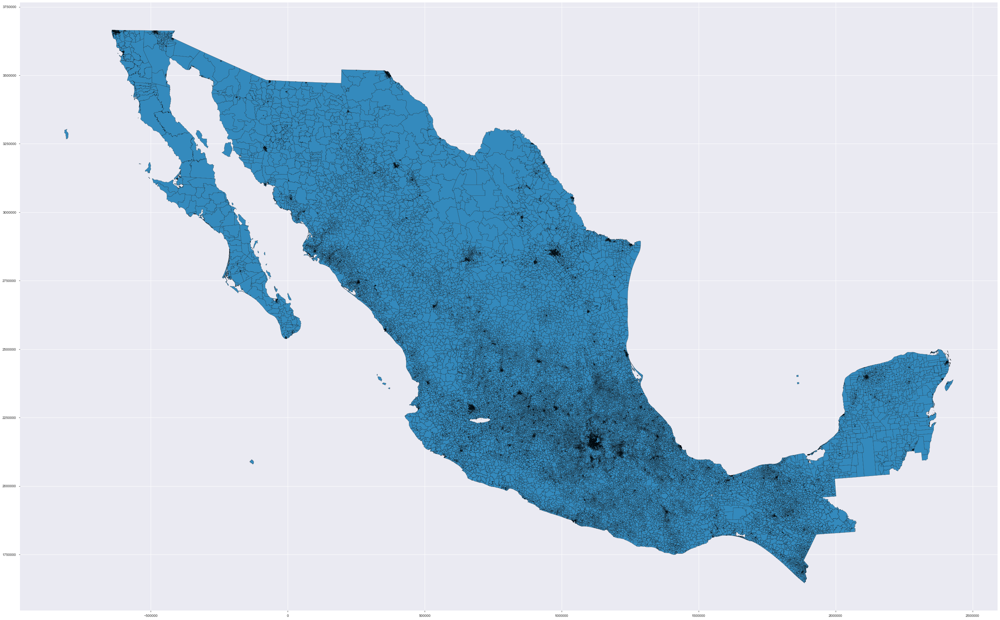

In [28]:
#muestra de la cartografía de SECCIONES
plt.rcParams['figure.figsize'] = [50, 70]
mapa_secc.plot(edgecolor='black')

In [29]:
#se guarda shapefile en geojson
#mapa_secc.to_file("secciones.geojson", driver='GeoJSON')

In [30]:
#se carga la cartografía de estados (shapefile)
fp2 = "C:/Users/miguel.alvarez/Google Drive/Cartografias/Cartografia INE/entidad.shp"
mapa_edo = gpd.read_file(fp2)
#type(mapa_edo)
mapa_edo["id"] = mapa_edo["entidad"].astype(str)
mapa_edo.head()

,gid,id,entidad,nombre,circunscri,crc,padron,lnominal,geometry
0,129,1,1,AGUASCALIENTES,2,1,947129,939109,"POLYGON ((-102.29831 22.45985, -102.29599 22.4..."
1,130,2,2,BAJA CALIFORNIA,1,8,2745326,2717857,"MULTIPOLYGON (((-114.71429 32.72202, -114.7191..."
2,131,3,3,BAJA CALIFORNIA SUR,1,4,519170,514223,"MULTIPOLYGON (((-112.08233 25.34398, -112.0822..."
3,132,4,4,CAMPECHE,3,10,644487,637005,"MULTIPOLYGON (((-91.93864 21.23621, -91.93901 ..."
4,133,5,5,COAHUILA,2,11,2163696,2140471,"POLYGON ((-102.31629 29.87767, -102.31551 29.8..."


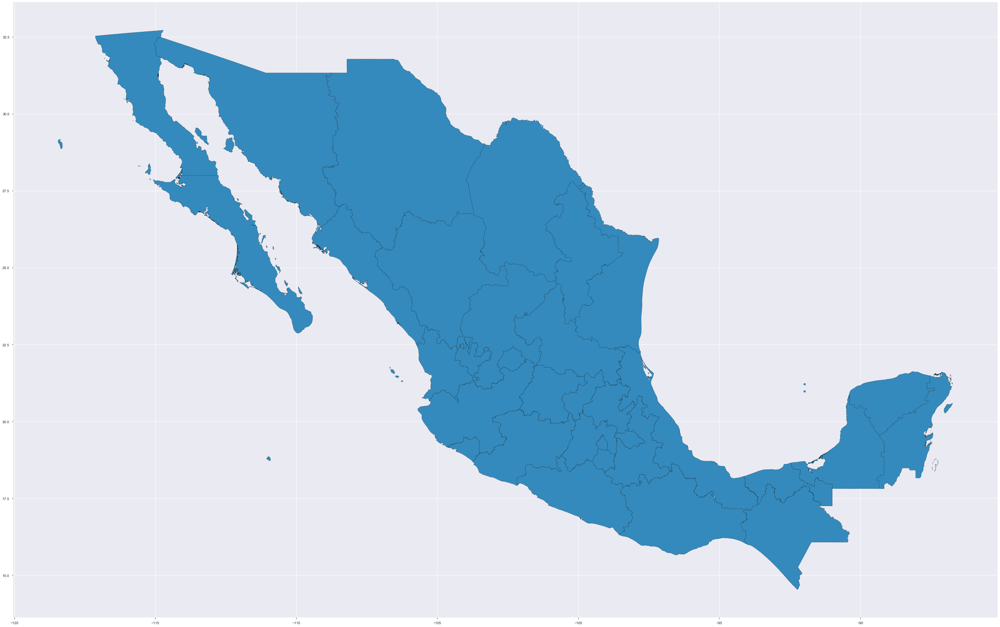

In [31]:
#muestra de la cartografía de estados
plt.rcParams['figure.figsize'] = [50, 70]
mapa_edo.plot(edgecolor='black')


## Escenario 1: Mapas de tipología y atipicidad (6 indicadores)

In [32]:
#se agrega una column id a resultados_ind6
resultados_ind6["ID"] = resultados_ind6["EDO"].astype(str) + resultados_ind6["MUN"].astype(str) + resultados_ind6["SECC"].astype(str)
#se une con mapa_secc
mapa_secc_ind6 = mapa_secc.merge(resultados_ind6, how='inner',on=['ID'])
mapa_secc_ind6

,ENTIDAD,MUNICIPIO,SECCION,TIPO,CONTROL,DISTRITO_L,ID,Geometry1_,DISTRITO_F,ENT,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
0,1,1,1,2,168.0,6,111,None,3,01,...,0.018006,0.593570,-1.339904,-0.617475,-1.023269,0.499700,0.031331,-0.282479,G0,Tipica
1,1,1,2,2,172.0,6,112,None,3,01,...,0.022384,0.619956,-1.619224,-0.941906,-0.497444,-0.178221,0.439981,-0.835125,G0,Tipica
2,1,1,3,2,178.0,6,113,None,3,01,...,0.020073,0.507722,-1.497155,-0.888122,-0.709889,0.583883,0.381837,-0.192317,G0,Tipica
3,1,1,4,2,188.0,6,114,None,3,01,...,0.012593,0.578094,-2.182153,-0.303258,-0.586010,-0.001078,0.308678,-0.166312,G0,Tipica
4,1,1,5,2,189.0,6,115,None,3,01,...,0.023664,0.708441,-2.022951,0.268037,0.245581,-0.244711,1.188297,-1.000839,G0,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68875,32,17,1905,2,2164.0,4,32171905,1=X<B/,4,32,...,0.026606,0.985717,0.621060,0.306442,0.028026,-0.439845,-0.153024,-0.173216,G1,Tipica
68876,32,17,1906,2,2551.0,4,32171906,1=X<B/,4,32,...,0.033218,0.970183,1.263495,0.104610,0.439944,-0.613683,0.355496,0.084176,G1,Tipica
68877,32,17,1907,2,2166.0,3,32171907,1=X<B/,4,32,...,0.017295,0.933516,-0.669230,0.672657,0.228975,-0.936658,0.140706,-0.084720,G1,Tipica
68878,32,17,1908,2,2168.0,3,32171908,1=X<B/,4,32,...,0.015044,0.936194,-0.364446,0.577012,0.579971,0.106893,-0.680909,-0.043694,G1,Tipica


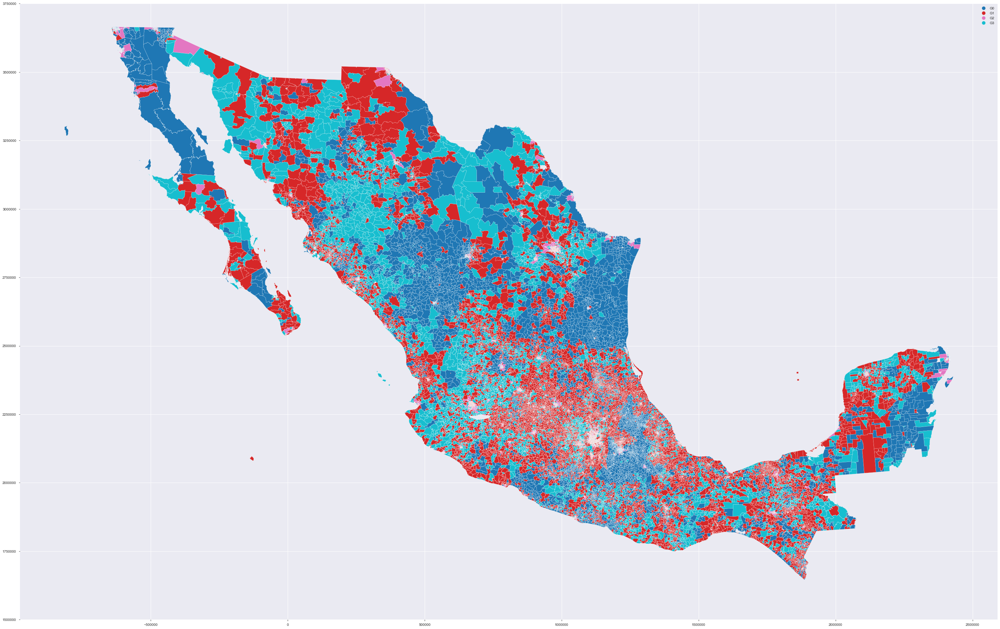

In [33]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind6.plot(ax=base,
                   column='TCE_seccional', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_TCE_ind6.png', dpi=400, bbox_inches='tight')

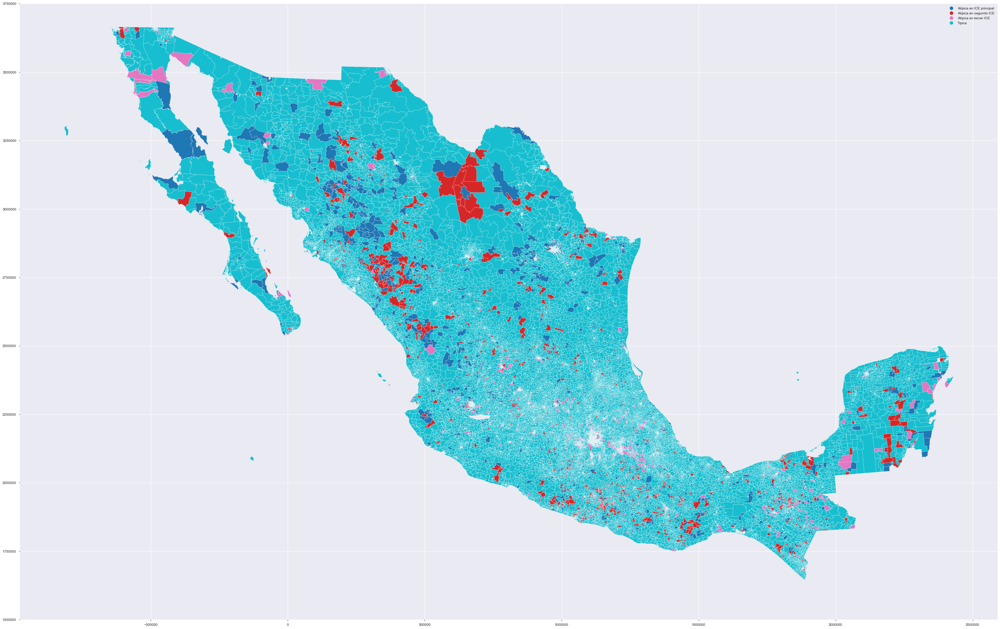

In [34]:
#mapa secciones atípicas
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind6.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_Atip_ind6.png', dpi=400, bbox_inches='tight')


## Escenario 2: Mapas de tipología y atipicidad (6 indicadores con previa transformación log)

In [35]:
#se agrega una column id a resultados ind6_tf
resultados_ind6_tf["ID"] = resultados_ind6_tf["EDO"].astype(str) + resultados_ind6_tf["MUN"].astype(str) + resultados_ind6_tf["SECC"].astype(str)
#se une con mapa_secc
mapa_secc_ind6_tf = mapa_secc.merge(resultados_ind6_tf, how='inner',on=['ID'])
mapa_secc_ind6_tf.head()

,ENTIDAD,MUNICIPIO,SECCION,TIPO,CONTROL,DISTRITO_L,ID,Geometry1_,DISTRITO_F,ENT,...,Var_Prop_LNE,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,TCE_seccional,Atipicidad
0,1,1,1,2,168.0,6,111,None,3,01,...,0.018006,0.593570,-1.420385,0.145421,0.902135,-0.974283,0.188212,-0.290280,G2,Tipica
1,1,1,2,2,172.0,6,112,None,3,01,...,0.022384,0.619956,-1.484090,1.076196,0.100013,-0.595830,0.445393,-0.846153,G2,Tipica
2,1,1,3,2,178.0,6,113,None,3,01,...,0.020073,0.507722,-1.572029,0.287141,1.100664,-0.540583,0.576194,-0.175004,G2,Tipica
3,1,1,4,2,188.0,6,114,None,3,01,...,0.012593,0.578094,-2.272771,0.027035,0.339379,-0.357964,0.439526,-0.150339,G2,Tipica
4,1,1,5,2,189.0,6,115,None,3,01,...,0.023664,0.708441,-2.051602,-0.041894,-0.367075,0.472668,1.200188,-0.967114,G2,Tipica


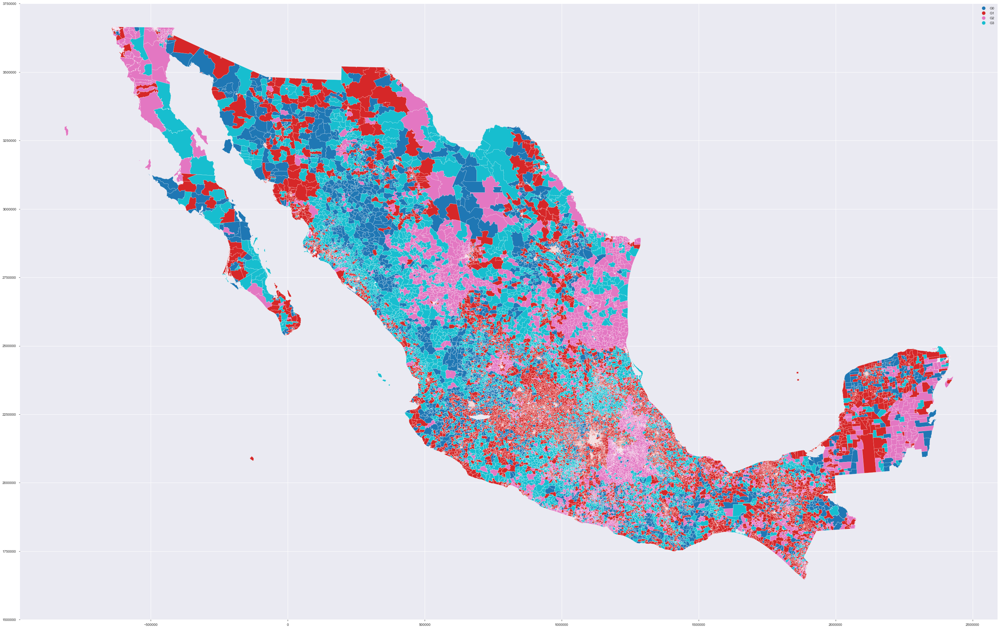

In [36]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind6_tf.plot(ax=base,
                   column='TCE_seccional', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_TCE_ind6_tf.png', dpi=400, bbox_inches='tight')

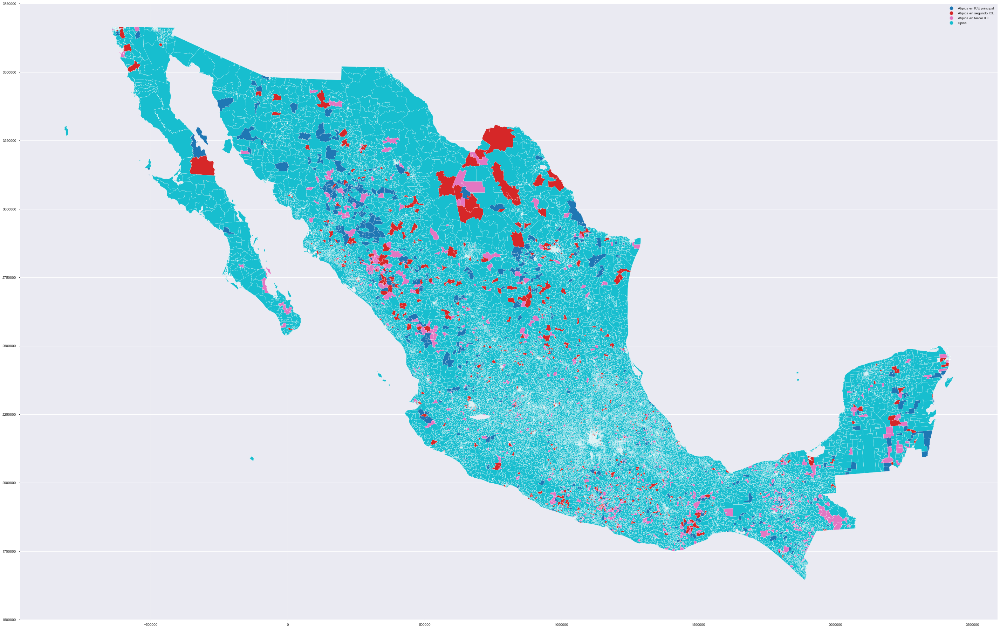

In [37]:
#mapa secciones atípicas
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind6_tf.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_Atip_ind6_tf.png', dpi=400, bbox_inches='tight')

<br>

## Escenario 3: Mapas de tipología y atipicidad (7 indicadores)

In [38]:
#se agrega una column id a resultados_ind7
resultados_ind7["ID"] = resultados_ind7["EDO"].astype(str) + resultados_ind7["MUN"].astype(str) + resultados_ind7["SECC"].astype(str)
#se une con mapa_secc
mapa_secc_ind7 = mapa_secc.merge(resultados_ind7, how='inner',on=['ID'])
mapa_secc_ind7

,ENTIDAD,MUNICIPIO,SECCION,TIPO,CONTROL,DISTRITO_L,ID,Geometry1_,DISTRITO_F,ENT,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
0,1,1,1,2,168.0,6,111,None,3,01,...,0.593570,-1.303615,-0.761664,-0.992390,0.563558,0.249142,-0.293879,-0.057075,G0,Tipica
1,1,1,2,2,172.0,6,112,None,3,01,...,0.619956,-1.275521,-1.186960,-0.456955,-0.066157,0.943323,-0.734248,-0.052284,G0,Tipica
2,1,1,3,2,178.0,6,113,None,3,01,...,0.507722,-1.297523,-1.089835,-0.667212,0.664426,0.583125,-0.114703,-0.070803,G0,Tipica
3,1,1,4,2,188.0,6,114,None,3,01,...,0.578094,-2.276477,-0.532959,-0.543394,0.096031,0.589248,-0.114919,-0.017634,G0,Tipica
4,1,1,5,2,189.0,6,115,None,3,01,...,0.708441,-1.575461,-0.115961,0.344143,-0.039609,1.893331,-0.709303,-0.020118,G0,Tipica
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68875,32,17,1905,2,2164.0,4,32171905,1=X<B/,4,32,...,0.985717,0.669853,0.367043,0.014622,-0.446533,-0.065860,-0.219353,-0.060770,G2,Tipica
68876,32,17,1906,2,2551.0,4,32171906,1=X<B/,4,32,...,0.970183,1.558680,0.181879,0.422687,-0.620878,0.302179,0.181628,-0.038861,G1,Tipica
68877,32,17,1907,2,2166.0,3,32171907,1=X<B/,4,32,...,0.933516,-0.867061,0.620032,0.232923,-0.895532,0.309365,-0.057038,0.046706,G2,Tipica
68878,32,17,1908,2,2168.0,3,32171908,1=X<B/,4,32,...,0.936194,-0.742161,0.605161,0.572299,0.058309,-0.668578,-0.230169,-0.009786,G2,Tipica


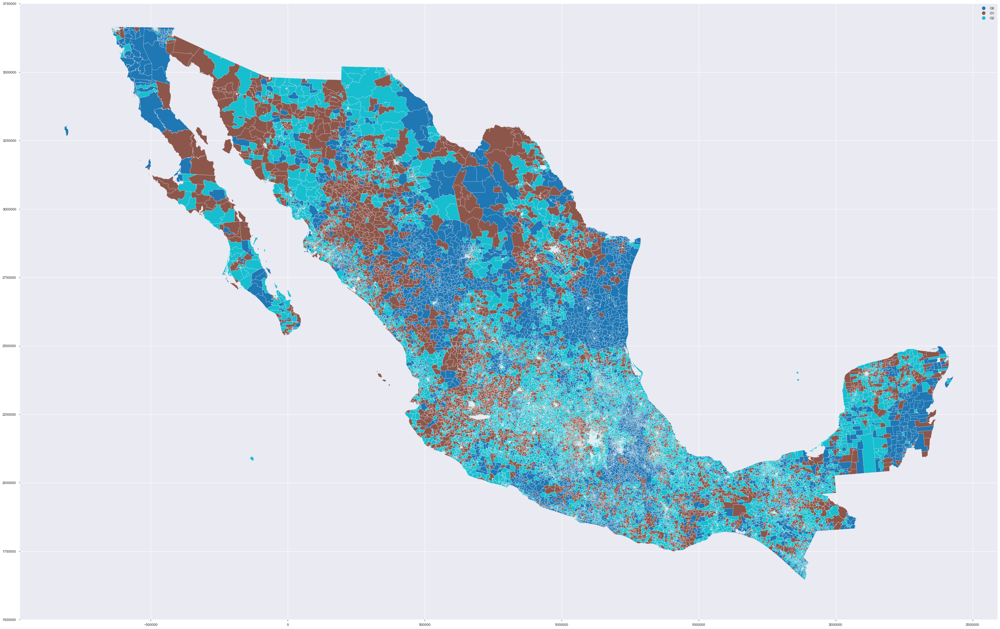

In [39]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind7.plot(ax=base,
                   column='TCE_seccional', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_TCE_ind7.png', dpi=400, bbox_inches='tight')

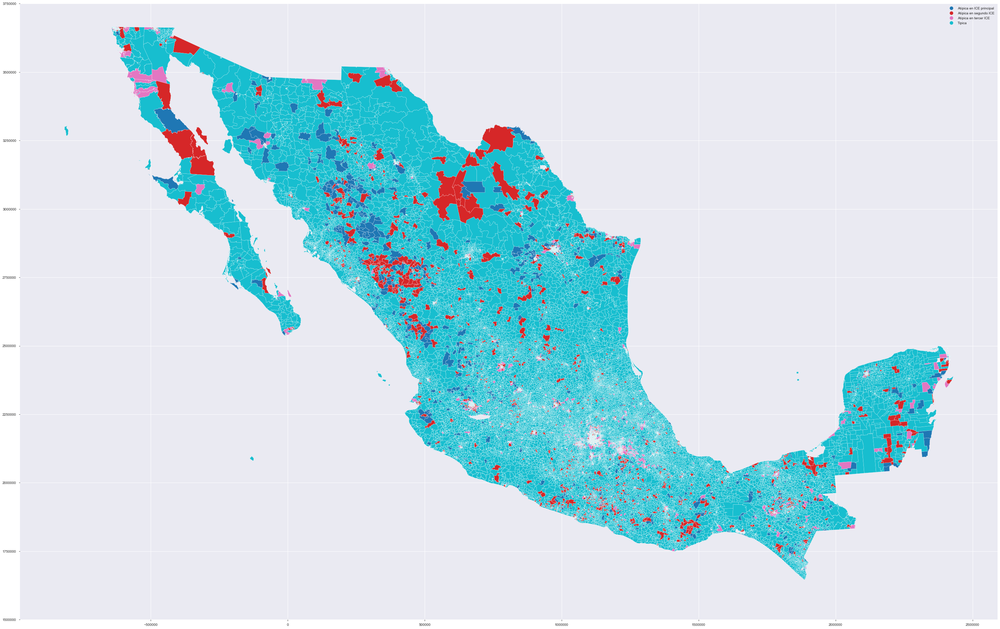

In [40]:
#mapa secciones atípicas
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind7.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_Atip_ind7.png', dpi=400, bbox_inches='tight')


## Escenario 4: Mapas de tipología y atipicidad (7 indicadores con previa transformación log)

In [41]:
#se agrega una column id a resultados_ind7
resultados_ind7_tf["ID"] = resultados_ind7_tf["EDO"].astype(str) + resultados_ind7_tf["MUN"].astype(str) + resultados_ind7_tf["SECC"].astype(str)
#se une con mapa_secc
mapa_secc_ind7_tf = mapa_secc.merge(resultados_ind7_tf, how='inner',on=['ID'])
mapa_secc_ind7_tf.head()

,ENTIDAD,MUNICIPIO,SECCION,TIPO,CONTROL,DISTRITO_L,ID,Geometry1_,DISTRITO_F,ENT,...,Autocorr_LNE,CP1 (ICE principal),CP2 (segundo ICE),CP3 (tercer ICE),CP4,CP5,CP6,CP7,TCE_seccional,Atipicidad
0,1,1,1,2,168.0,6,111,None,3,01,...,0.593570,-1.380900,0.235502,0.987207,0.174321,-1.031383,-0.259218,-0.051463,G2,Tipica
1,1,1,2,2,172.0,6,112,None,3,01,...,0.619956,-1.172735,1.180895,0.250408,0.814100,-0.776371,-0.735472,-0.050563,G2,Tipica
2,1,1,3,2,178.0,6,113,None,3,01,...,0.507722,-1.378901,0.396082,1.233281,0.642450,-0.693359,-0.040666,-0.062698,G2,Tipica
3,1,1,4,2,188.0,6,114,None,3,01,...,0.578094,-2.355842,0.162183,0.475724,0.621321,-0.494705,-0.057554,-0.012087,G2,Tipica
4,1,1,5,2,189.0,6,115,None,3,01,...,0.708441,-1.592724,0.113705,-0.088602,1.992047,0.061838,-0.648476,-0.015879,G2,Tipica


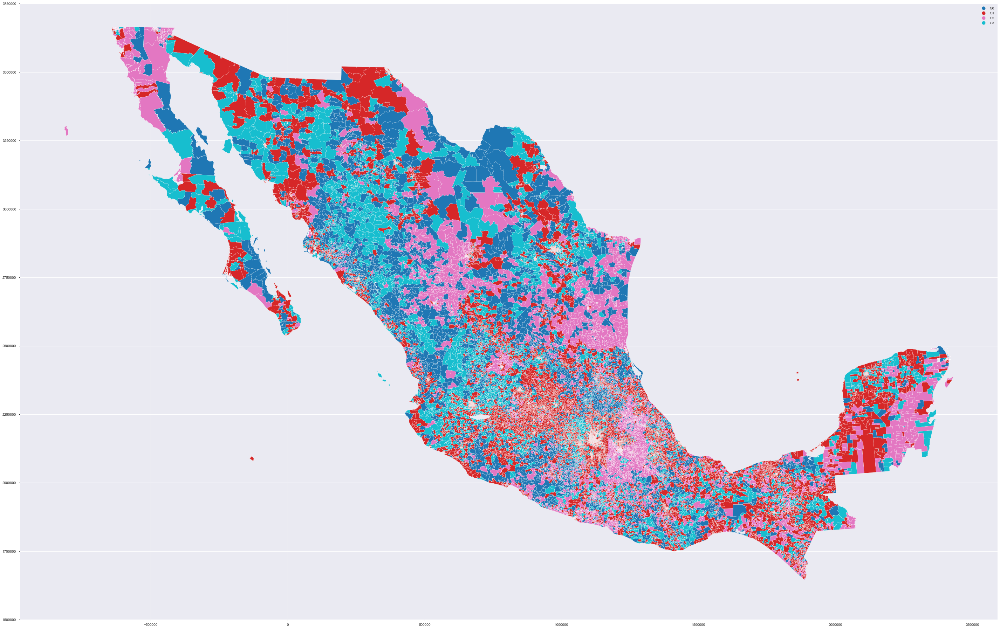

In [42]:
#mapa tipología
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind7_tf.plot(ax=base,
                   column='TCE_seccional', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_TCE_ind7_tf.png', dpi=400, bbox_inches='tight')

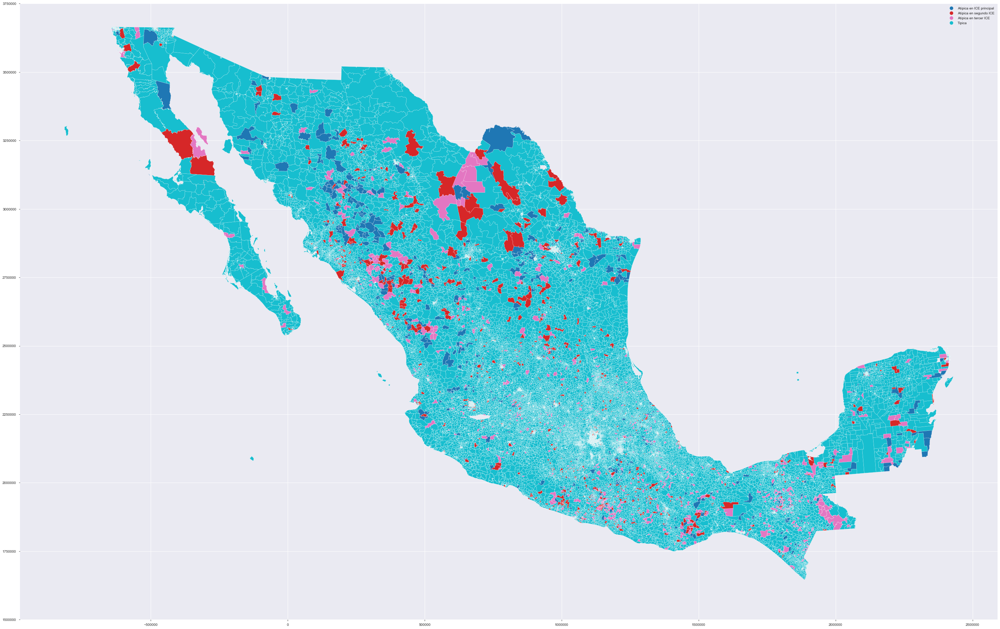

In [43]:
#mapa secciones atípicas
base = mapa_edo.plot(facecolor="none", edgecolor='black')
mapa_secc_ind7_tf.plot(ax=base,
                   column='Atipicidad', 
                   categorical=True,
                   edgecolor='white',
                   legend=True).set_ylim([1500000, 3750000])
plt.savefig('Pyplotly_Mapa_Secc_Atip_ind7_tf.png', dpi=400, bbox_inches='tight')

<br>

# Mapas con plotly

In [44]:
# import json
# with open('C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/secciones.geojson') as f:
#     secciones_s = json.load(f)

In [45]:
#print(secciones_s["features"][0])
#print(secciones_s["features"][0]["properties"])
#secciones_s

## Escenario 3

In [46]:
#mapa de TCE
# eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO','DTO', 'LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional', 'Atipicidad']
# fig = px.choropleth(resultados_ind7, geojson=secciones_s, 
#                     locations='ID', featureidkey="properties.id",
#                     color='TCE_seccional',
#                     color_discrete_map={
#                     'G0':'blue',
#                     'G1':'green',
#                     'G2': 'orange',
#                     'G3': 'grey'},
#                     hover_name='SECC',
#                     hover_data = eti,
#                     title = 'TCE seccional (7 indicadores)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", showsubunits=True, 
#                 subunitcolor="Blue")
# fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_mapa_secc_ind7.html")

In [47]:
#mapa de atipicidad
# eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO', 'DTO','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional', 'Atipicidad']
# fig = px.choropleth(resultados_ind7, geojson=secciones_s, 
#                     locations='ID', featureidkey="properties.id",
#                     color='Atipicidad',
#                     color_discrete_sequence= px.colors.sequential.Reds,
#                     hover_name='SECC',
#                     hover_data = eti,
#                     title = 'Mapa secciones electorales atípicas (7 indicadores)')
# fig.update_geos(fitbounds="locations",
#                 visible=True,
#                 showcountries=True, 
#                 countrycolor="Black", 
#                 showsubunits=True, 
#                 subunitcolor="Blue")
# fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_mapa_secc_Atip_ind7.html")

## Escenario 4:

In [48]:
#mapa de TCE
# eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO', 'DTO','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional', 'Atipicidad']
# fig = px.choropleth(resultados_ind7_tf, geojson=secciones_s, 
#                     locations='ID', featureidkey="properties.id",
#                     color='TCE_seccional',
#                     color_discrete_map={
#                     'G0':'blue',
#                     'G1':'green',
#                     'G2': 'orange',
#                     'G3': 'grey'},
#                     hover_name='SECC',
#                     hover_data = eti,
#                     title = 'TCE seccional (7 indicadores con transformación log)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", showsubunits=True, 
#                 subunitcolor="Blue")
# fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_mapa_secc_ind7_tf.html")

In [49]:
#mapa de atipicidad
# eti=['NOMBRE_ESTADO','NOMBRE_MUNICIPIO', 'DTO','LNE', 'Densidad_LNE', 'Razon_LNE_PE', 'TC_LNE_2019', 'Coef_Var_LNE', 'Var_Prop_LNE', 'Autocorr_LNE', 'CP1 (ICE principal)', 'CP2 (segundo ICE)', 'CP3 (tercer ICE)', 'TCE_seccional', 'Atipicidad']
# fig = px.choropleth(resultados_ind7_tf, geojson=secciones_s, 
#                     locations='ID', featureidkey="properties.id",
#                     color='Atipicidad',
#                     color_discrete_sequence= px.colors.sequential.Reds,
#                     hover_name='SECC',
#                     hover_data = eti,
#                     title = 'Mapa secciones electorales atípicas (7 indicadores con transformación log)')
# fig.update_geos(fitbounds="locations",
#                 visible=False,
#                 showcountries=True, 
#                 countrycolor="Black", 
#                 showsubunits=True, 
#                 subunitcolor="Blue")
# #fig.show()
# fig.write_html("C:/Users/miguel.alvarez/Google Drive/INFOTEC/Proyecto/Code-Data/Secc/4_Resumen-Mapas/Pyplotly_mapa_secc_Atip_ind7_tf.html")

# Referencias

- https://stackoverflow.com/questions/60870063/plotly-express-choropleth-for-country-regions
- https://plotly.github.io/plotly.py-docs/generated/plotly.express.choropleth.html
- https://plotly.com/python/builtin-colorscales/#builtin-sequential-color-scales
- https://plotly.com/python/map-configuration/